In [1]:
import astropy
import numpy as np
import matplotlib

from astropy.io import fits
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt

In [2]:
plt.rcParams['figure.figsize'] = (9, 6)

In [3]:
def v_indx(v_val): # v_val must be in m/s
    return int((v_val - 3.99321598442 * 10 ** 4) / (-9.77198303456 * 10 ** 2))

In [2]:
# doing initial Fourier transform

def fft(im):
    im[np.where((im < 0) | (im > 20) | (np.isnan(im) == True))] = 0 # 0 and 20 = velocity limits
    im = np.fft.fftshift(np.fft.fft2(im))
        
    return im

In [5]:
# masking the low-frequency data

def mask(im, radius):
    rows, cols = im.shape
    center_row, center_col = int(rows / 2), int(cols / 2)
    mask = np.ones((rows, cols), np.uint8)
    radius = radius
    center = [center_row, center_col]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= radius * radius
    mask[mask_area] = 0
    im = im * mask 
    
    return im

In [7]:
# transforming back from Fourier space to regular image space

def ifft(im_masked):
    inv_im = np.fft.ifft2(np.fft.ifftshift(im_masked))
    return inv_im

In [8]:
def mask_border(im, amt = 300):
    rows, cols = im.shape
    maskb = np.ones((rows, cols))
    # upper border, lower border, left border, right border (in that order)
    maskb[:, 0:amt], maskb[:, cols - amt:cols], maskb[0:amt, :], maskb[rows - amt:rows, :] = 0., 0., 0., 0. 

    maskb = gaussian_filter(maskb, sigma = 500)
    # only applying mask to borders of image
    im[:, 0:amt] = im[:, 0:amt] * maskb[:, 0:amt]
    im[:, cols - amt:cols] = im[:, cols - amt:cols] * maskb[:, cols - amt:cols]
    im[0:amt, :] = im[0:amt, :] * maskb[0:amt, :]
    im[rows - amt:rows, :] = im[rows - amt:rows, :] * maskb[rows - amt:rows, :]
    
    
    return im

In [9]:
# produces whole row of fft images: top row = FFT w/h mask, bottom row = final image w/h FFT, mask, IFFT applied to it

def fft_row(v, vmin, vmax, radii):
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/MW_foreground_SMC.fits') # reset
    fig, ax = plt.subplots(1, 4, figsize = (50, 25), constrained_layout = True, facecolor = 'w')
    j = 0

    for i in radii:
        im = file[0].data[v, :, :]
        im_nonoise = mask_border(im)
        im_fft = fft(im_nonoise)
        im_masked = mask(im_fft, i)
        im_final = ifft(im_masked)
    
        ax[j].imshow(np.flip(np.abs(im_final), axis = 0), cmap = 'magma', vmin = vmin, vmax = vmax)
        ax[j].grid(False)
        ax[j].axes.xaxis.set_visible(False)
        ax[j].axes.yaxis.set_visible(False)
        ax[j].set_title('r = ' + str(i), fontsize = 70)
    
        j += 1
        file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/MW_foreground_SMC.fits') # reset

In [10]:
# produces j 1 image w/h FFT/mask/IFFT applied to it

def fft_indiv(v, radius):
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/MW_foreground_SMC.fits') # reset
    im = file[0].data[v, :, :]
    im_nonoise = mask_border(im)
    im_fft = fft(im_nonoise)
    im_masked = mask(im_fft, radius)
    im_final = ifft(im_masked)
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/MW_foreground_SMC.fits') # reset
    
    return im_final

In [11]:
im1 = fft_indiv(41, 1)

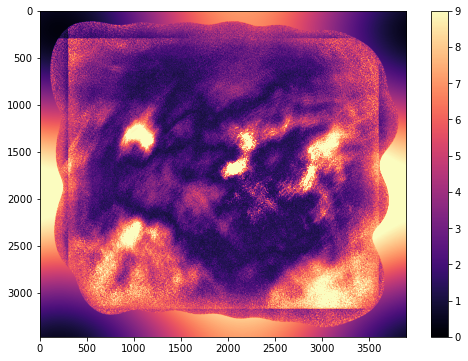

In [12]:
plt.imshow(np.flip(np.abs(im1), axis = 0), cmap = 'magma', vmin = 0, vmax = 9)
plt.colorbar()

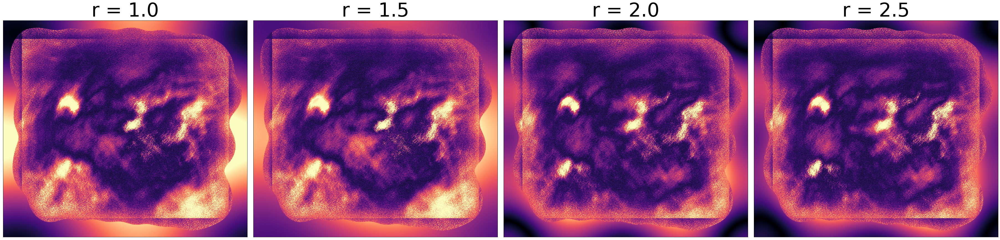

In [13]:
fft_row(41, 0, 9, np.arange(1, 3, 0.5))

In [14]:
im2 = fft_indiv(30, 1)

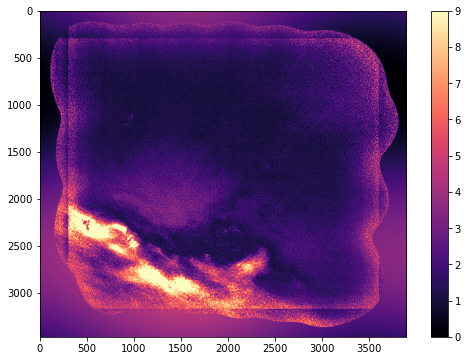

In [15]:
plt.imshow(np.flip(np.abs(im2), axis = 0), cmap = 'magma', vmin = 0, vmax = 9)
plt.colorbar()

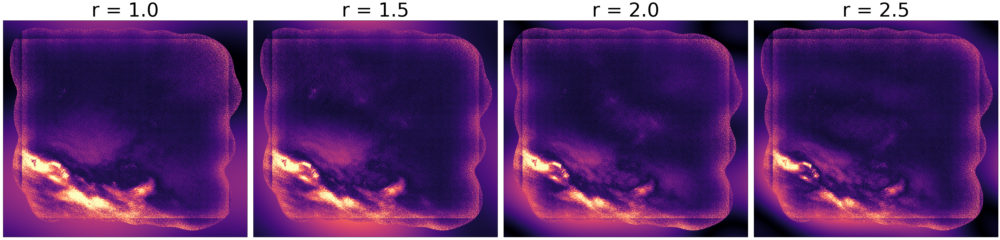

In [16]:
fft_row(30, 0, 9, np.arange(1, 3, 0.5))

In [17]:
im3 = fft_indiv(46, 1)

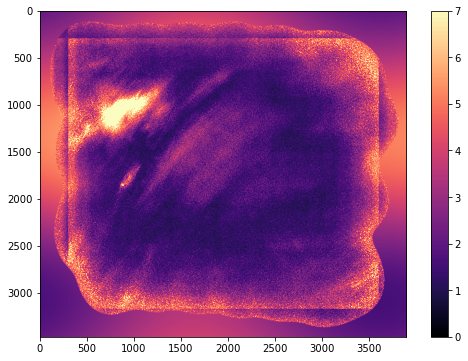

In [18]:
plt.imshow(np.flip(np.abs(im3), axis = 0), cmap = 'magma', vmin = 0, vmax = 7)
plt.colorbar()

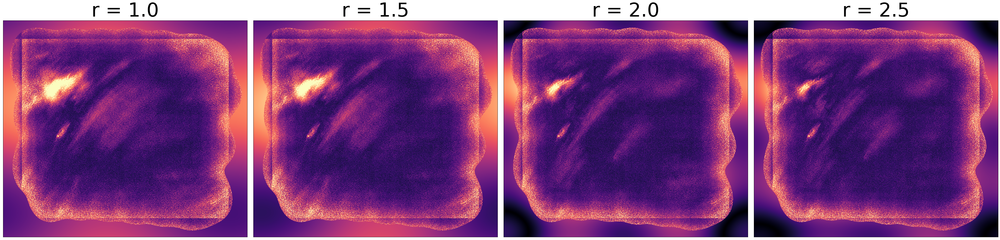

In [19]:
fft_row(46, 0, 7, np.arange(1, 3, 0.5))
